##DataSet

In [ ]:
import os
import torch
import xml.etree.ElementTree as ET
from PIL import Image
from torch.utils.data import Dataset
import torchvision.transforms as transforms

class CarLicensePlateDataset(Dataset):
    def __init__(self, annotations_dir, img_dir, transform=None):
        self.annotations_dir = annotations_dir
        self.img_dir = img_dir
        self.transform = transform
        self.xml_files = [os.path.join(annotations_dir, f) for f in os.listdir(annotations_dir) if f.endswith('.xml')]
        self.data = self._load_annotations()

    def _load_annotations(self):
        """Helper function to load all the annotations from XML files."""
        data = []

        for xml_file in self.xml_files:
            tree = ET.parse(xml_file)
            root = tree.getroot()

            filename = root.find('filename').text
            size = root.find('size')
            width = int(size.find('width').text)
            height = int(size.find('height').text)

            bboxes = []
            labels = []

            # Loop through each object in the XML file (multiple bounding boxes)
            for obj in root.findall('object'):
                label = obj.find('name').text  # Get label
                bndbox = obj.find('bndbox')
                xmin = int(bndbox.find('xmin').text)
                ymin = int(bndbox.find('ymin').text)
                xmax = int(bndbox.find('xmax').text)
                ymax = int(bndbox.find('ymax').text)
                bboxes.append([xmin, ymin, xmax, ymax])  # Add bbox coordinates
                labels.append(label)  # Add label

            data.append({
                'filename': filename,
                'bboxes': torch.tensor(bboxes, dtype=torch.float32),
                'labels': labels,
                'size': [width, height]
            })

        return data

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        img_data = self.data[idx]
        img_path = os.path.join(self.img_dir, img_data['filename'])
        image = Image.open(img_path).convert("RGB")
        bboxes = img_data['bboxes']
        labels = img_data['labels']

        if self.transform:
            image, bboxes = self.apply_transforms(image, bboxes, img_data['size'])

        return image, bboxes, labels, img_data['filename']

    def apply_transforms(self, image, bboxes, original_size):
        """Apply transformations to the image and adjust the bounding boxes accordingly."""
        width, height = original_size

        if isinstance(self.transform, transforms.Compose):
            for t in self.transform.transforms:
                if isinstance(t, transforms.Resize):
                    new_size = t.size
                    bboxes = self.resize_bbox(bboxes, (width, height), new_size)
                elif isinstance(t, transforms.RandomHorizontalFlip):
                    if random.random() < 0.5:  # Horizontal flip with 50% chance
                        image = F.hflip(image)
                        bboxes = self.flip_bbox_horizontal(bboxes, width)

        transformed_image = self.transform(image)
        return transformed_image, bboxes

    def resize_bbox(self, bboxes, original_size, new_size):
        """Resize bounding boxes according to the new image size."""
        original_w, original_h = original_size
        new_w, new_h = new_size

        scale_x = new_w / original_w
        scale_y = new_h / original_h

        bboxes[:, [0, 2]] *= scale_x  # Scale xmin and xmax
        bboxes[:, [1, 3]] *= scale_y  # Scale ymin and ymax

        return bboxes

    def flip_bbox_horizontal(self, bboxes, image_width):
        """Flip bounding boxes horizontally."""
        bboxes[:, [0, 2]] = image_width - bboxes[:, [2, 0]]  # Flip xmin and xmax
        return bboxes


##Sampeling from dataset

Sample name: Cars376.png
Sample Image Shape: <PIL.Image.Image image mode=RGB size=400x265 at 0x7803018DEFE0>
Sample Bounding Box: tensor([[159., 178., 252., 203.]])
Sample Label: ['licence']


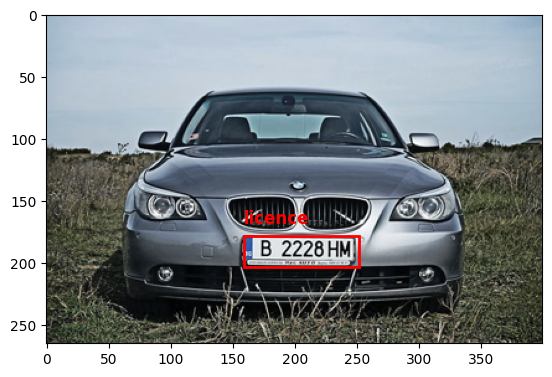

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np
# Directory where XML files are stored
annotations_dir = '/content/'

# Directory where images are stored
img_dir = '/content/'

#Define image transformations (optional)
transform = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize images to 224x224
    transforms.ToTensor()  # Convert images to tensors
])

# Create the dataset
car_dataset = CarLicensePlateDataset(annotations_dir=annotations_dir, img_dir=img_dir)


# Test loading a sample from the dataset
sample_image, sample_bbox, sample_label,sample_filename = car_dataset[17]
print("Sample name:", sample_filename)
print("Sample Image Shape:", sample_image)
print("Sample Bounding Box:", sample_bbox)
print("Sample Label:", sample_label)

# Convert the image tensor back to a NumPy array for visualization (if needed)
if isinstance(sample_image, torch.Tensor):
    sample_image = sample_image.permute(1, 2, 0).numpy()  # Convert from C x H x W to H x W x C

# Create a figure and axis
fig, ax = plt.subplots()

# Display the image
ax.imshow(sample_image)



# Loop through the bounding boxes and draw each one
for bbox, label in zip(sample_bbox, sample_label):
    xmin, ymin, xmax, ymax = bbox

    # Calculate width and height of the bounding box
    width = xmax - xmin
    height = ymax - ymin



# Create a rectangle patch and add it to the axis
    rect = patches.Rectangle((xmin, ymin), width, height, linewidth=2, edgecolor='r', facecolor='none')
    ax.add_patch(rect)
    ax.text(xmin, ymin - 10, label, color='red', fontsize=12, weight='bold')

# Show the plot with the bounding box
plt.show()

## Data Loader

Batch 1
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 50.9600, 156.0449,  76.7200, 174.5019]]), tensor([[ 66.0800, 166.9513,  85.6800, 177.0187]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars35.png', 'Cars227.png']


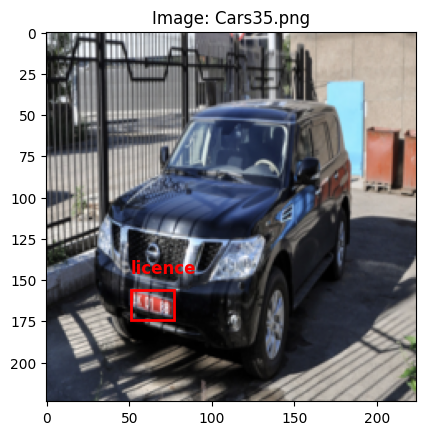

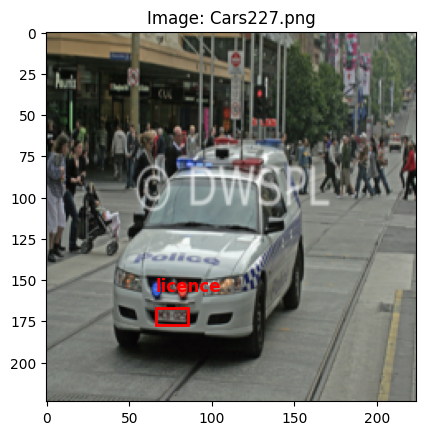

Batch 2
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 76.1600, 133.4044, 117.6000, 152.3200]]), tensor([[111.5022, 120.6154, 190.1511, 166.3144]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars251.png', 'Cars367.png']


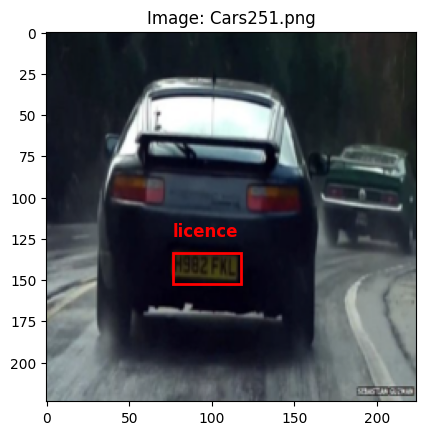

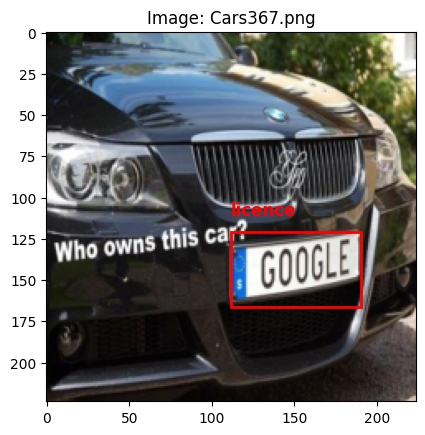

Batch 3
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 84.5600, 137.3867, 142.8000, 158.2933]]), tensor([[ 72.0533,  98.5600, 147.0933, 129.6213]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars324.png', 'Cars118.png']


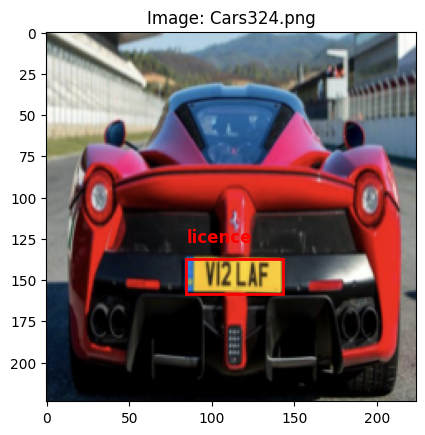

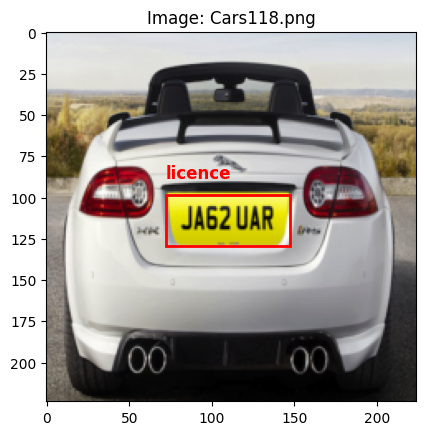

Batch 4
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 68.8800,  27.8756, 156.2400,  64.7111]]), tensor([[ 99.6800, 151.8502, 114.2400, 160.2397]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars323.png', 'Cars137.png']


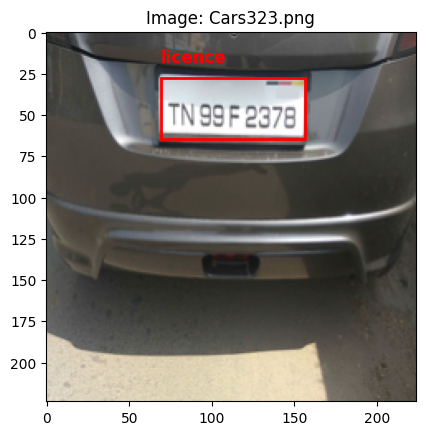

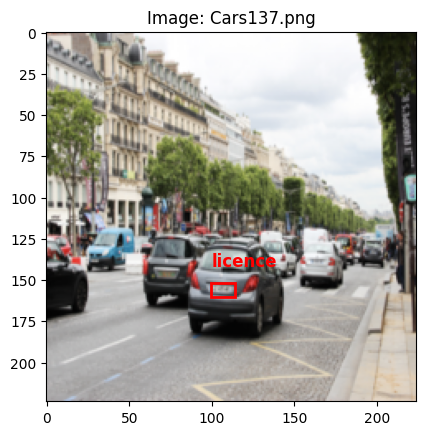

Batch 5
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[160.1600, 160.0000, 224.0000, 193.8286]]), tensor([[ 91.8400,  87.2509, 137.2000,  99.8352]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars256.png', 'Cars136.png']


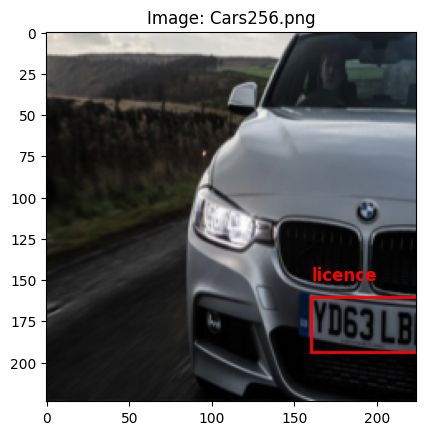

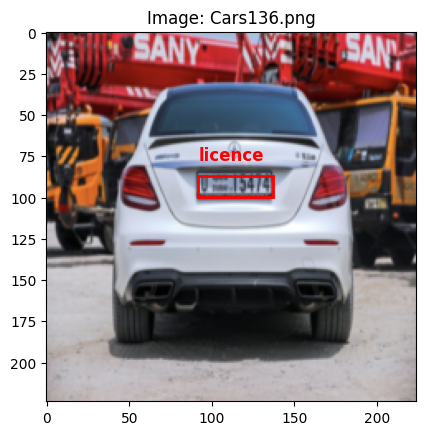

Batch 6
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 83.4400, 182.9333, 124.8800, 215.6000]]), tensor([[166.3200, 161.9176, 176.9600, 171.9850]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars217.png', 'Cars338.png']


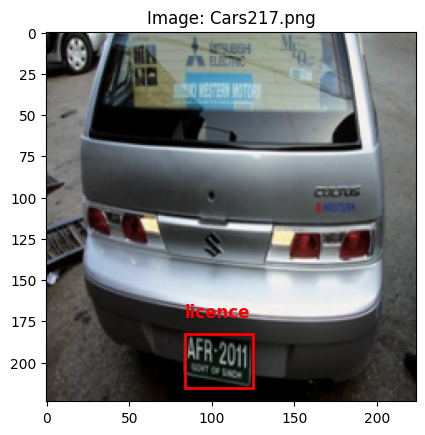

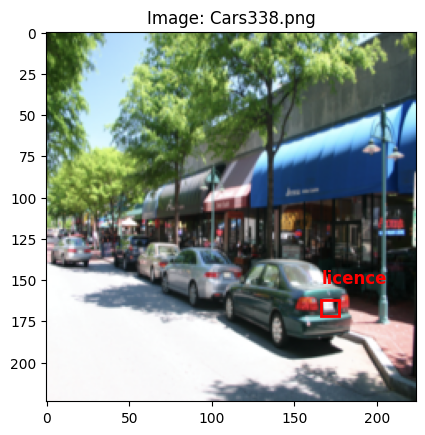

Batch 7
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[109.2000, 124.3739, 195.4400, 153.5637]]), tensor([[ 76.5570, 181.6436, 132.8608, 202.0073]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars419.png', 'Cars67.png']


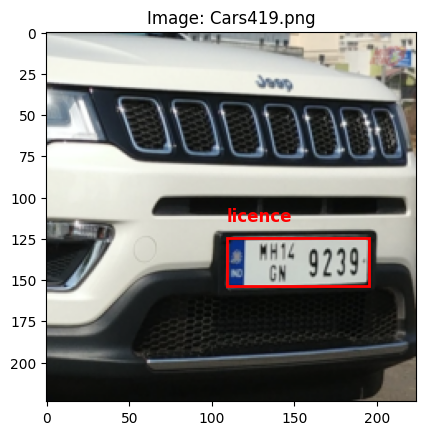

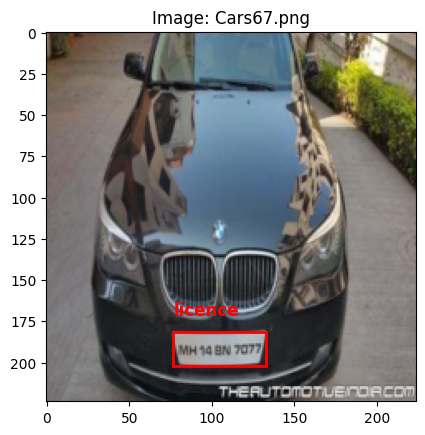

Batch 8
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[174.1600, 153.5281, 193.7600, 169.4682]]), tensor([[ 14.0000, 132.2667,  35.8400, 146.1333]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars407.png', 'Cars253.png']


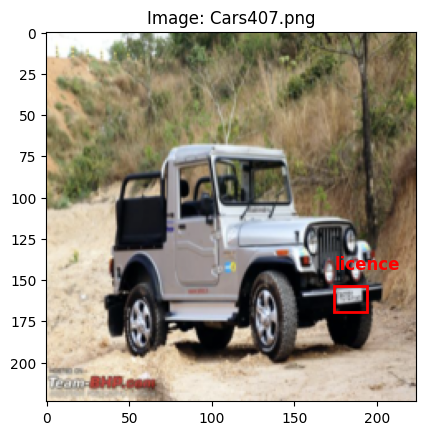

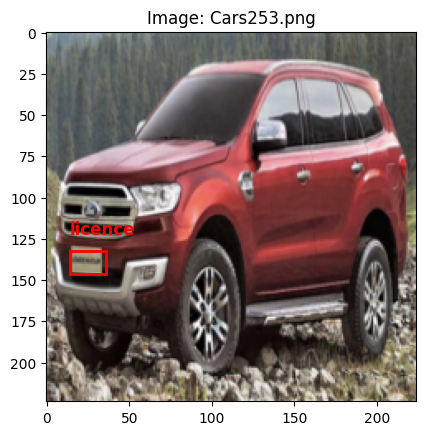

Batch 9
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 82.8800, 121.4458, 146.7200, 143.7108]]), tensor([[ 80.0800, 128.1070, 118.1600, 155.8261]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars287.png', 'Cars29.png']


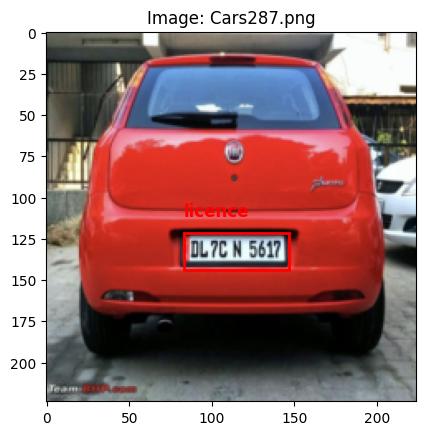

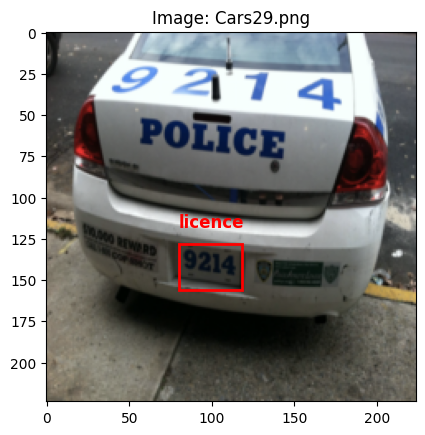

Batch 10
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 64.0000,  92.9600, 154.7907, 109.2000]]), tensor([[ 41.8133,  88.2560, 157.6960, 118.7200]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars429.png', 'Cars154.png']


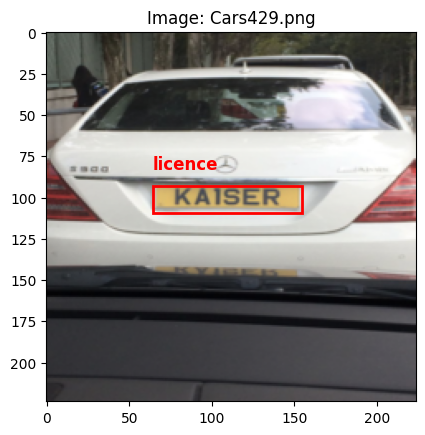

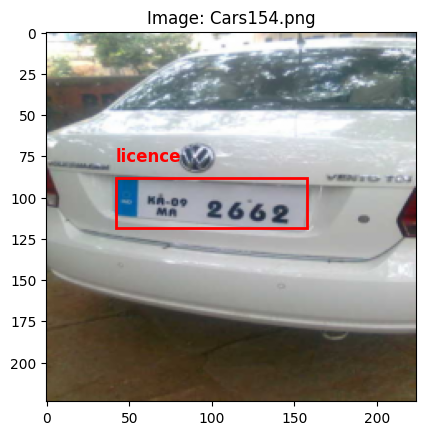

Batch 11
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 83.4400, 124.1446, 146.1600, 142.3614]]), tensor([[137.8462, 163.3814, 179.3767, 179.5464]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars159.png', 'Cars161.png']


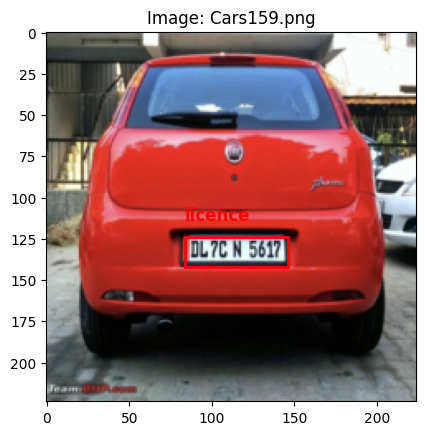

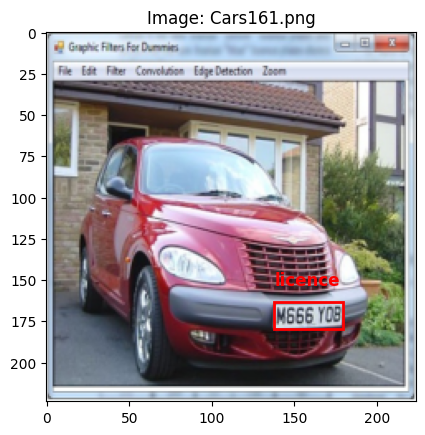

Batch 12
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 16.2400, 143.3600,  31.9200, 151.5733],
        [ 94.0800, 150.8267, 110.8800, 159.7867],
        [175.2800, 134.4000, 186.4800, 142.6133],
        [215.6000, 128.4267, 223.4400, 135.1467]]), tensor([[ 93.6320, 100.8000, 126.7840, 126.1867]])]
Labels: [['licence', 'licence', 'licence', 'licence'], ['licence']]
Filenames: ['Cars330.png', 'Cars339.png']


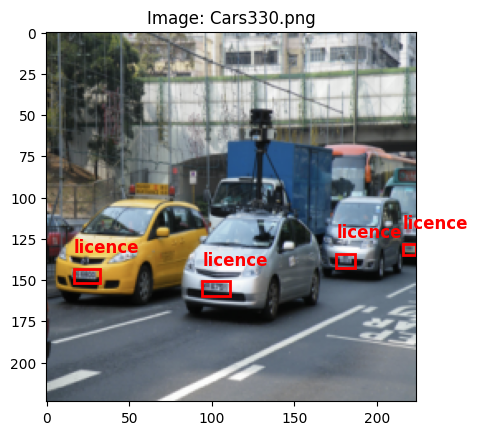

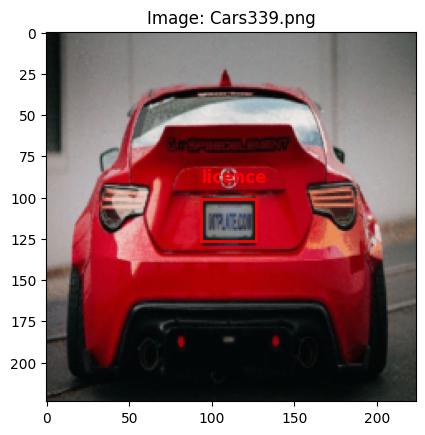

Batch 13
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 81.2000, 118.4928, 142.1000, 136.3478]]), tensor([[126.0000, 134.4000, 183.6800, 159.0400]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars409.png', 'Cars39.png']


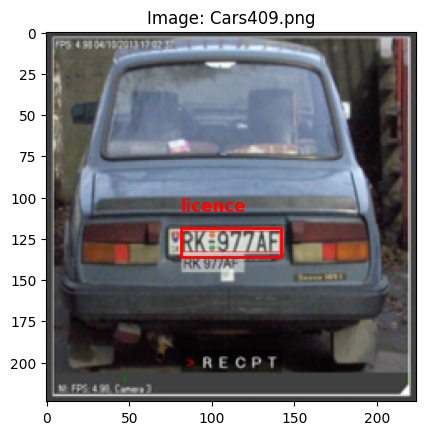

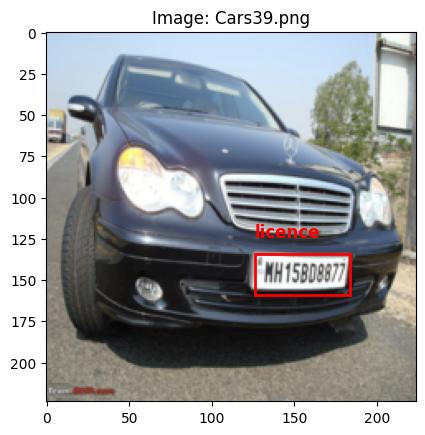

Batch 14
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 42.1424,  42.2400, 196.6644, 157.4400]]), tensor([[145.2138, 182.2897, 217.3057, 218.5931]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars312.png', 'Cars145.png']


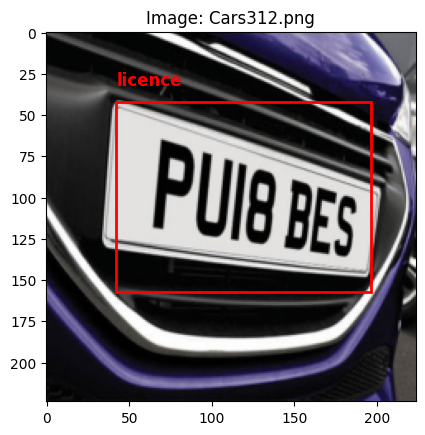

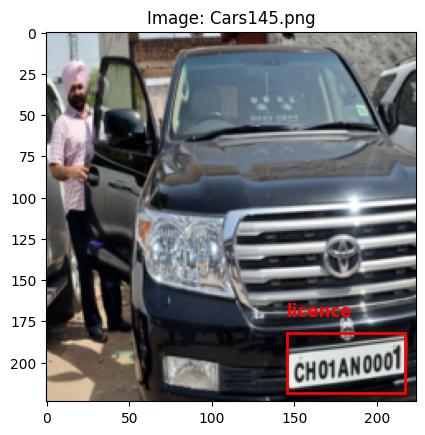

Batch 15
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 83.4400,  97.0667, 142.8000, 117.9733]]), tensor([[ 38.6400,  67.2000, 173.6000, 171.1360]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars388.png', 'Cars385.png']


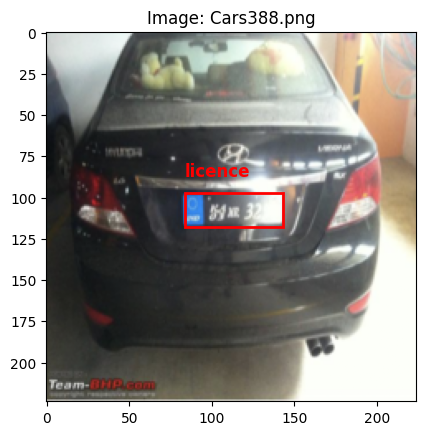

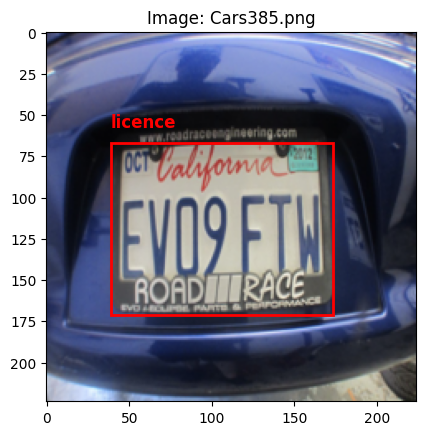

Batch 16
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 88.4000, 146.6667, 141.2000, 164.8000]]), tensor([[ 47.4133,  85.6178, 172.4800, 117.4756]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars372.png', 'Cars219.png']


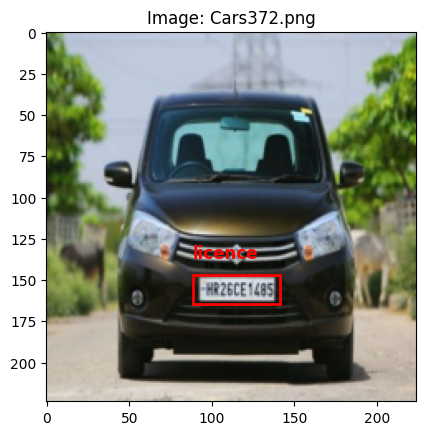

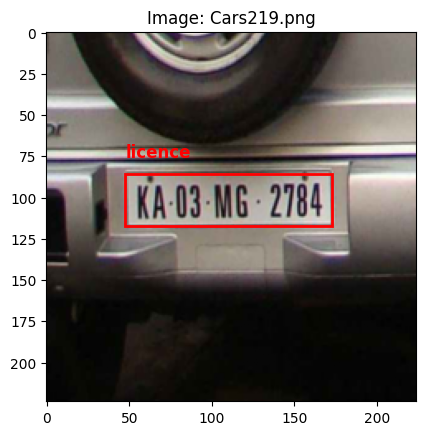

Batch 17
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[  6.1600,  56.7467,  49.2800,  75.6622],
        [  8.4000,  83.6267,  47.0400, 101.5467],
        [ 12.8800, 109.5111,  42.0000, 121.4578],
        [ 13.4400, 149.3333,  41.4400, 174.2222],
        [ 53.2000, 104.5333,  88.4800, 121.4578],
        [ 86.2400,  44.8000, 220.0800, 175.2178]]), tensor([[ 91.3920, 100.4138, 136.1920, 129.3793]])]
Labels: [['licence', 'licence', 'licence', 'licence', 'licence', 'licence'], ['licence']]
Filenames: ['Cars266.png', 'Cars8.png']


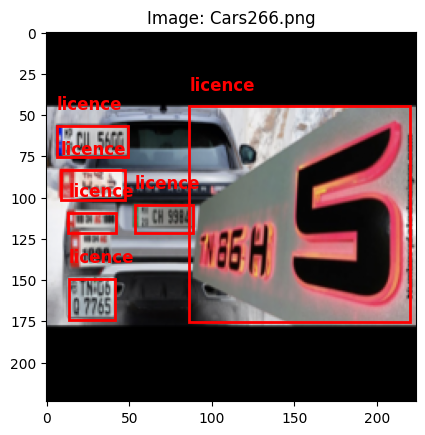

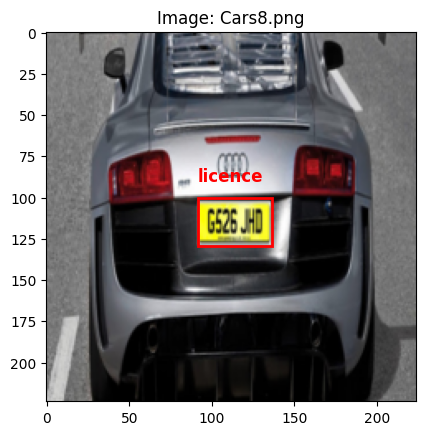

Batch 18
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[  3.1360,  11.9467, 220.8640, 191.1467]]), tensor([[ 88.1067,  96.0711, 140.0000, 113.4933]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars114.png', 'Cars427.png']


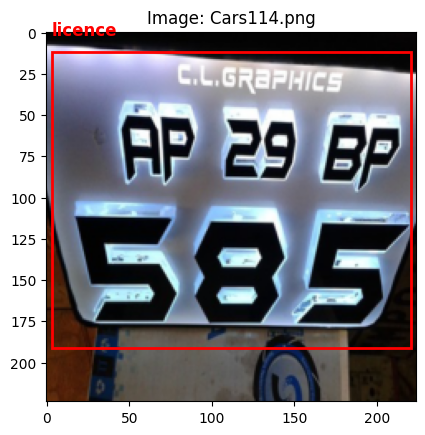

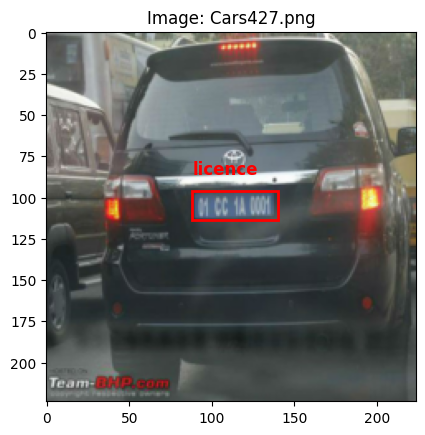

Batch 19
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 86.8000, 160.3137, 118.1600, 177.8824]]), tensor([[ 35.8400, 134.2322,  72.8000, 151.8502]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars334.png', 'Cars293.png']


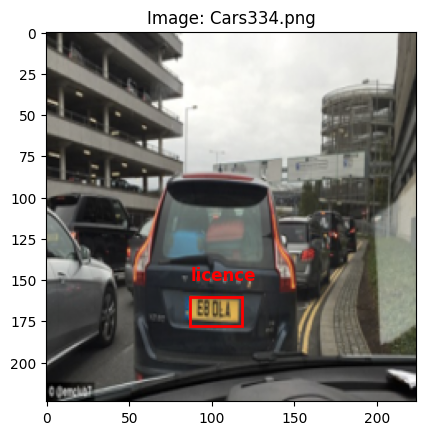

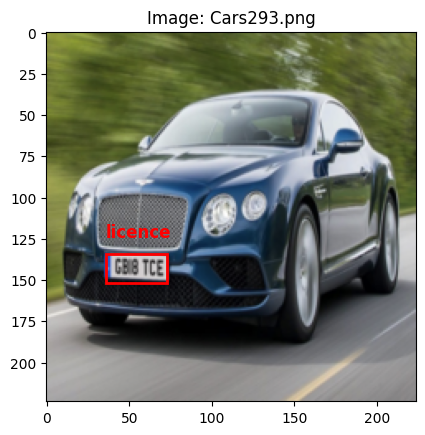

Batch 20
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 54.3200, 154.1953,  91.8400, 176.0744]]), tensor([[ 26.8800, 167.8076,  40.3200, 173.1959],
        [ 75.0400, 167.0378,  85.6800, 172.4261],
        [162.4000, 169.3471, 172.4800, 176.2749],
        [208.8800, 163.1890, 217.2800, 167.0378]])]
Labels: [['licence'], ['licence', 'licence', 'licence', 'licence']]
Filenames: ['Cars288.png', 'Cars277.png']


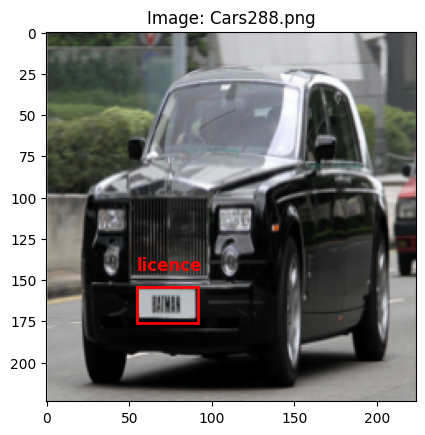

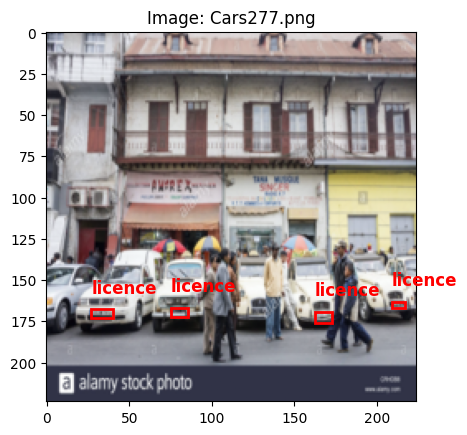

Batch 21
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 70.5600, 119.1311, 134.9600, 166.9513]]), tensor([[142.4640, 116.6027, 155.0080, 137.4685]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars241.png', 'Cars170.png']


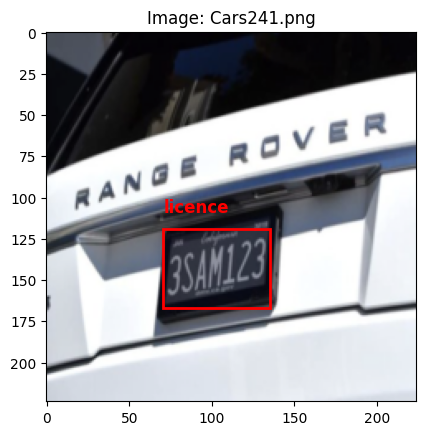

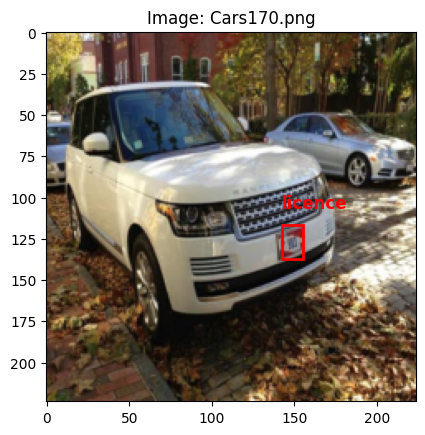

Batch 22
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[166.3200,  74.6667, 183.1200,  93.3333]]), tensor([[ 84.5600,  84.3733, 171.3600, 134.4000]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars81.png', 'Cars113.png']


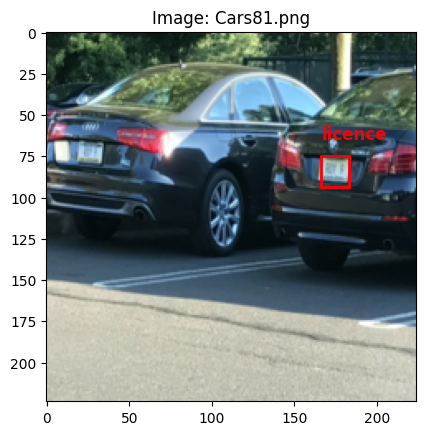

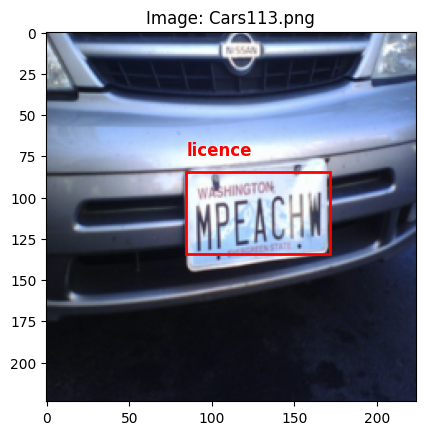

Batch 23
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 91.8400, 103.3103, 135.7440, 130.3448]]), tensor([[ 79.5200, 102.8060, 129.9200, 141.2537]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars301.png', 'Cars208.png']


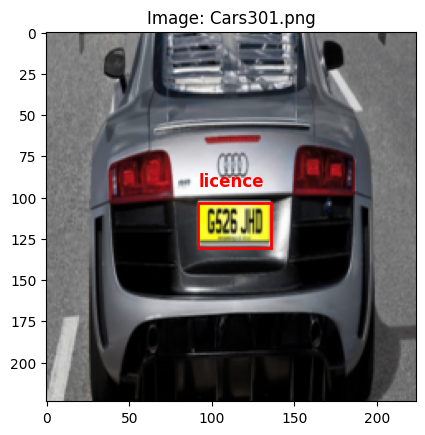

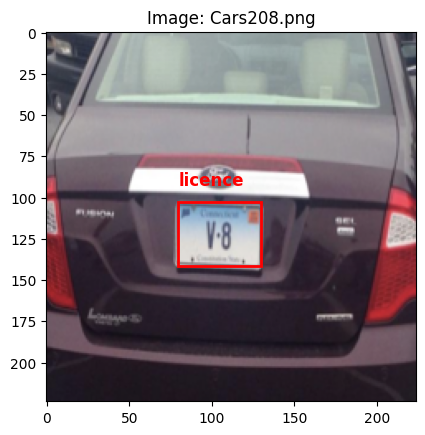

Batch 24
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 80.6400, 127.3579, 118.1600, 151.3311]]), tensor([[ 84.0000, 119.4667, 130.4800, 144.8533]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars66.png', 'Cars213.png']


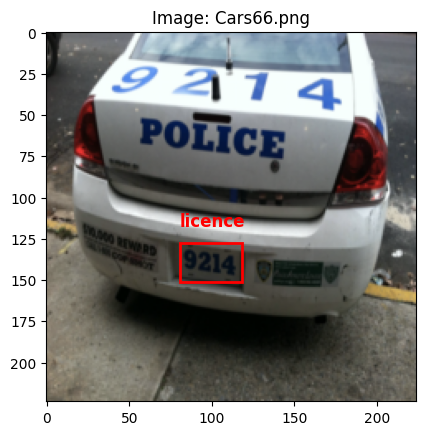

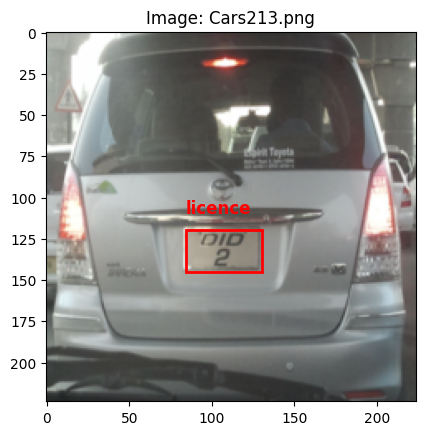

Batch 25
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 85.6800, 142.8528, 142.2400, 172.4377]]), tensor([[156.8000, 168.8615, 198.8000, 221.4154]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars363.png', 'Cars125.png']


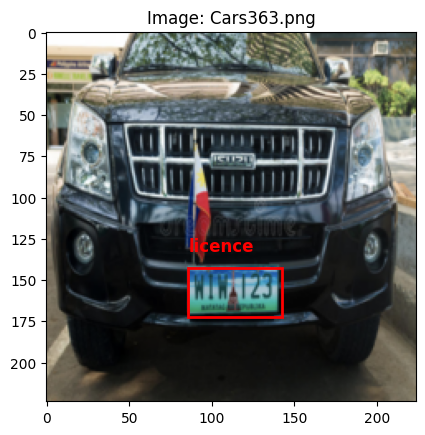

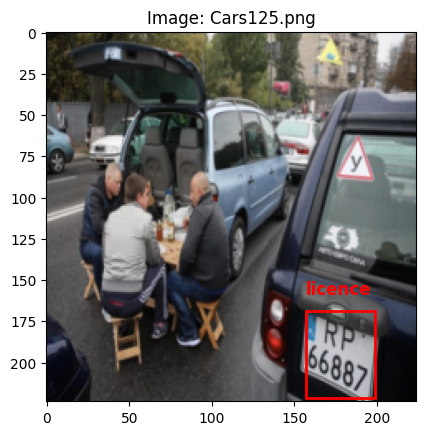

Batch 26
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 80.0800, 196.3733,  95.2000, 202.3467],
        [142.2400, 177.7067, 156.8000, 184.4267],
        [ 30.2400, 141.1200,  43.6800, 146.3467],
        [ 62.1600, 144.8533,  72.2400, 152.3200]]), tensor([[106.9600, 122.8657, 135.5200, 141.2537]])]
Labels: [['licence', 'licence', 'licence', 'licence'], ['licence']]
Filenames: ['Cars146.png', 'Cars13.png']


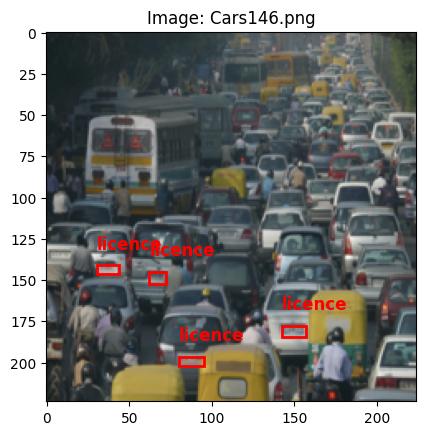

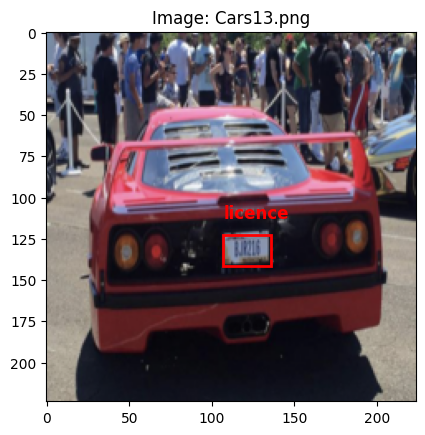

Batch 27
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 44.1285, 192.6400,  95.4518, 212.0533]]), tensor([[ 99.6800, 153.8783, 131.6000, 165.5652]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars152.png', 'Cars222.png']


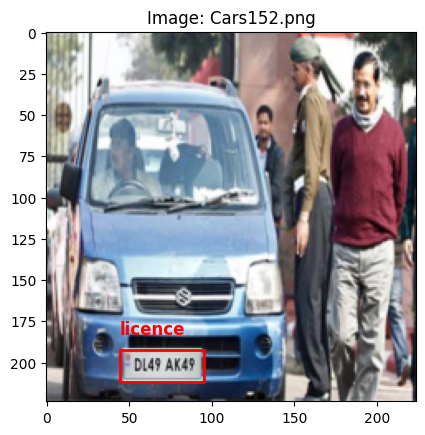

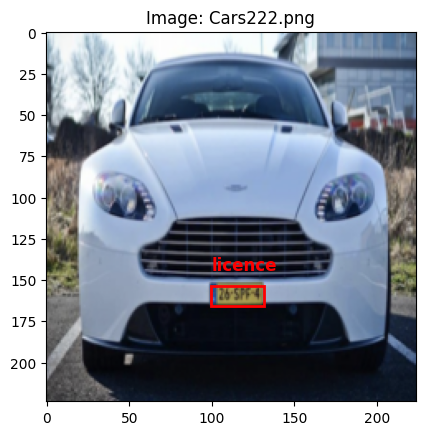

Batch 28
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 34.1600, 129.5868,  64.4000, 154.5785]]), tensor([[ 40.3200, 103.7867, 109.7600, 165.7600]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars364.png', 'Cars398.png']


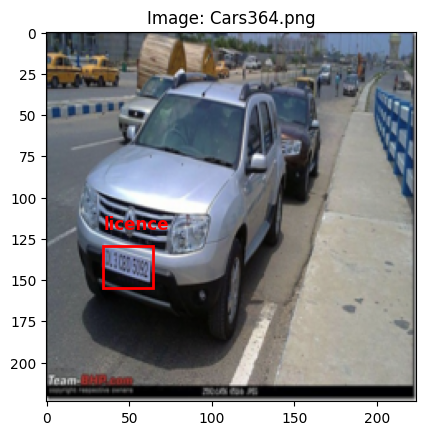

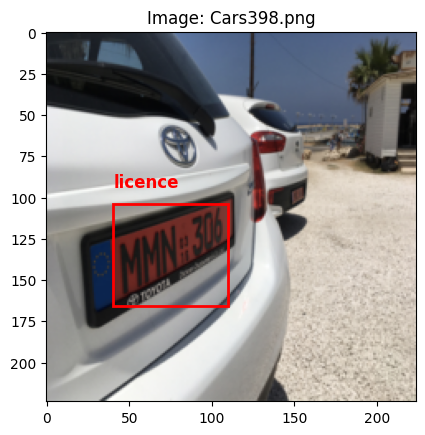

Batch 29
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[  3.3600, 106.7733,  26.8800, 120.2133]]), tensor([[ 67.2000, 156.8839, 182.0000, 184.5693]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars47.png', 'Cars64.png']


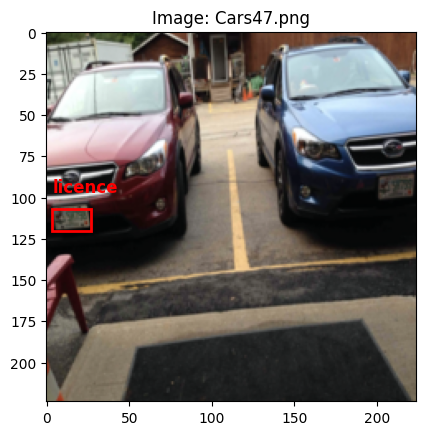

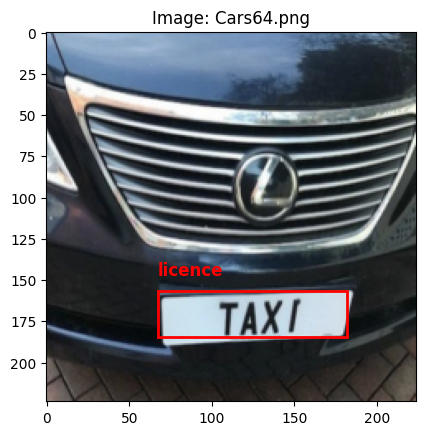

Batch 30
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 88.4800, 143.2446, 138.3200, 163.4335]]), tensor([[140.3248, 150.8760, 166.3109, 175.8678]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars297.png', 'Cars391.png']


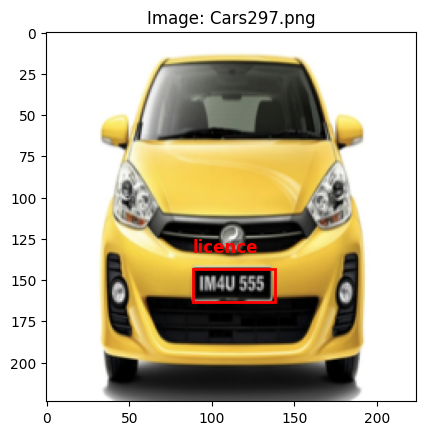

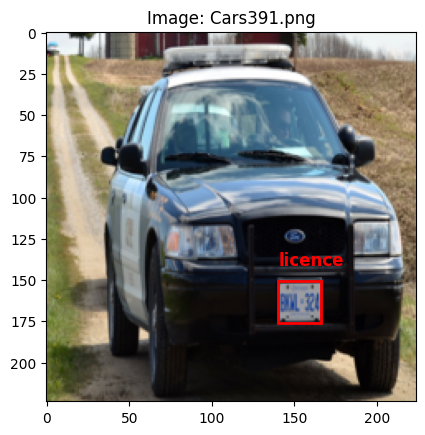

Batch 31
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 25.2000,  73.1733, 203.8400, 118.7200]]), tensor([[ 78.8480, 141.6800, 145.6000, 156.8000]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars60.png', 'Cars369.png']


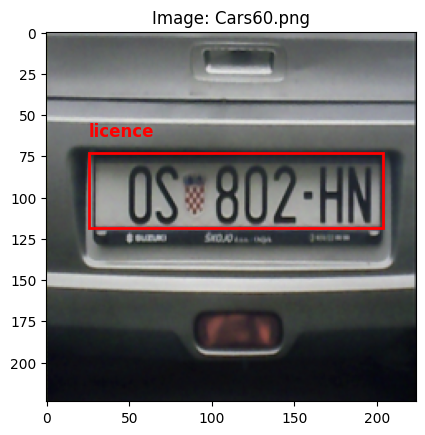

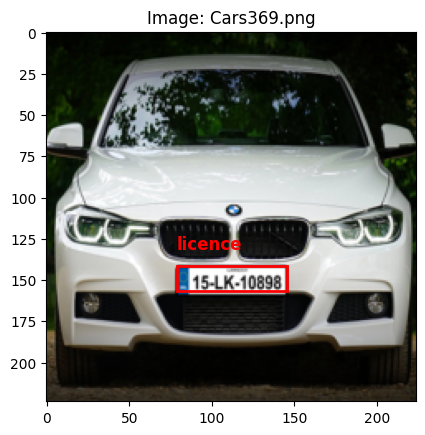

Batch 32
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 84.5600, 153.2632, 136.0800, 165.9595]]), tensor([[155.6800, 153.7910, 176.4000, 181.6517]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars281.png', 'Cars278.png']


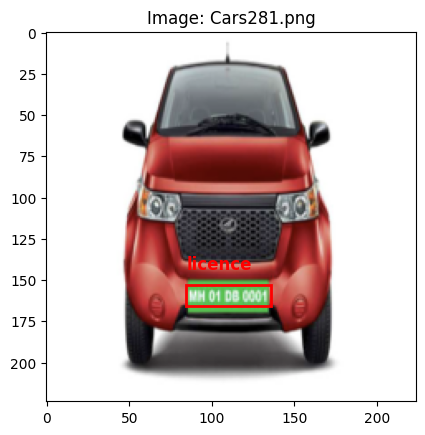

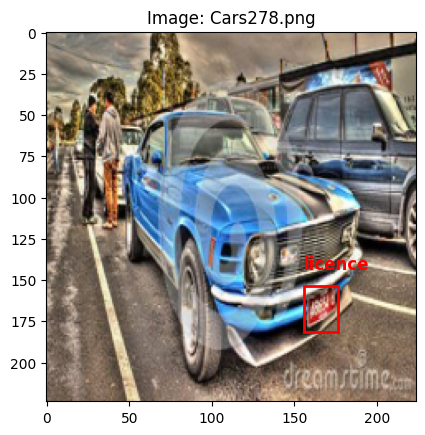

Batch 33
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[103.7867, 101.9200, 151.9467, 147.2800]]), tensor([[115.9200,  77.9130, 145.6000,  86.9030]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars95.png', 'Cars22.png']


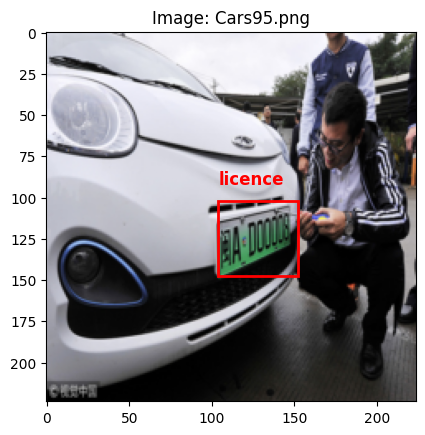

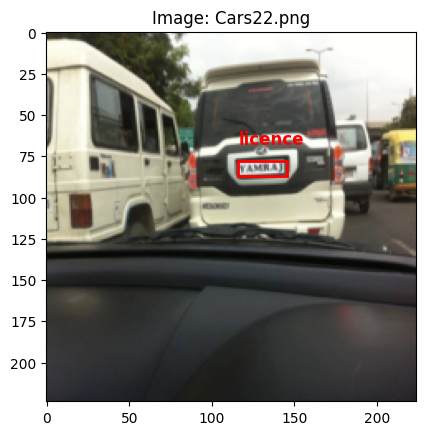

Batch 34
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 62.7200,  64.7111, 171.3600, 172.2311]]), tensor([[ 74.4800, 117.2267, 146.1600, 143.3600]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars128.png', 'Cars415.png']


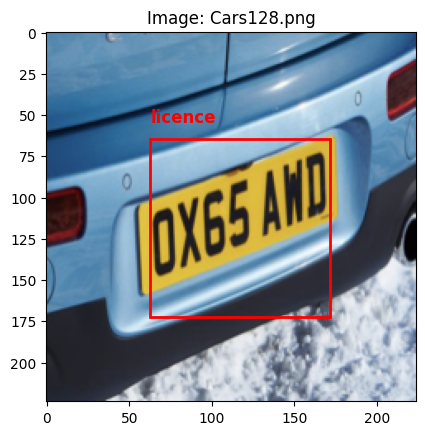

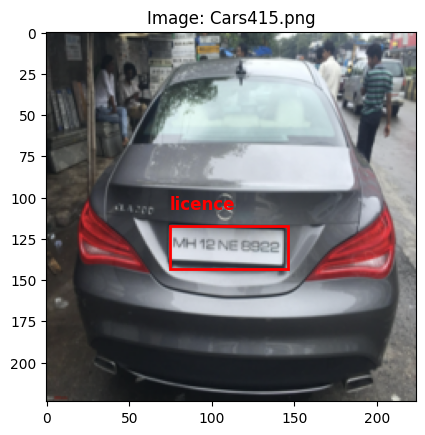

Batch 35
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[139.1716, 165.6907, 179.8185, 179.5464]]), tensor([[ 83.4400, 156.8000, 139.4400, 178.4533]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars115.png', 'Cars78.png']


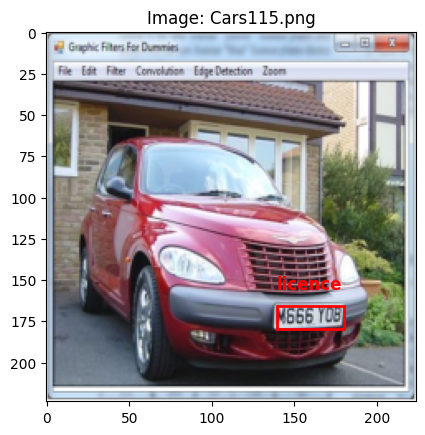

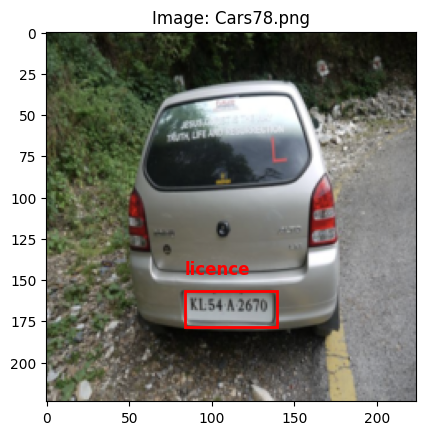

Batch 36
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[109.2000, 109.7600, 142.2400, 126.1867]]), tensor([[145.0400, 184.1778, 177.5200, 214.0444]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars122.png', 'Cars300.png']


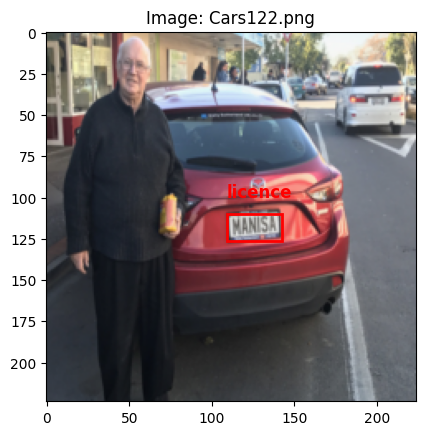

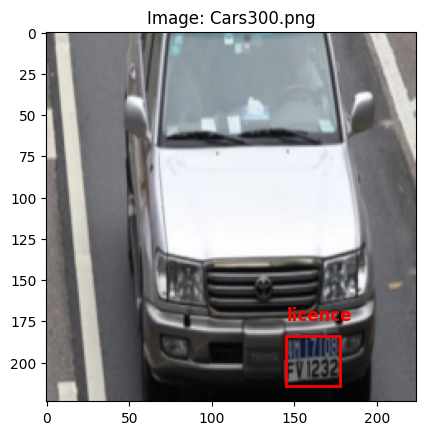

Batch 37
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 85.1200, 137.2000, 115.3600, 148.4000]]), tensor([[  2.8000,  70.9333, 219.3333, 144.9778]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars105.png', 'Cars76.png']


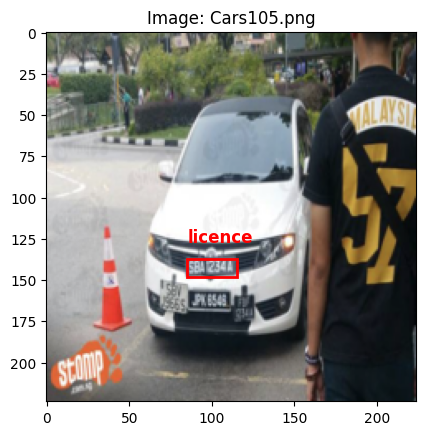

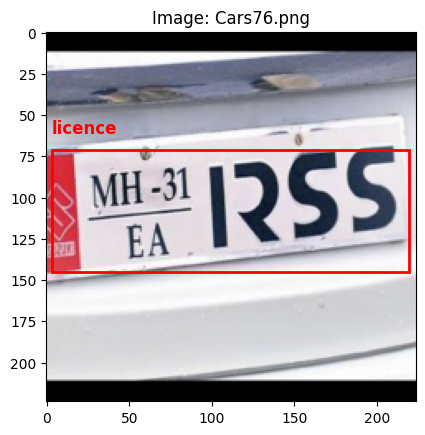

Batch 38
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 33.0400,  74.1053, 173.6000, 133.0526]]), tensor([[ 94.5280,  99.4483, 134.8480, 127.4483]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars199.png', 'Cars425.png']


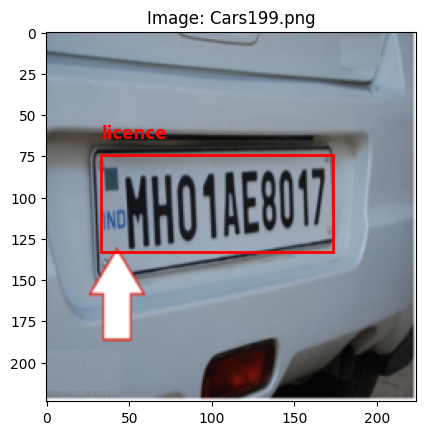

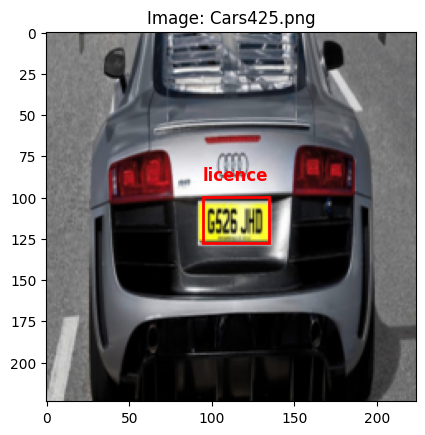

Batch 39
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 89.0400, 150.4604, 141.1200, 171.5925]]), tensor([[145.6000, 183.1822, 178.6400, 210.0622]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars376.png', 'Cars135.png']


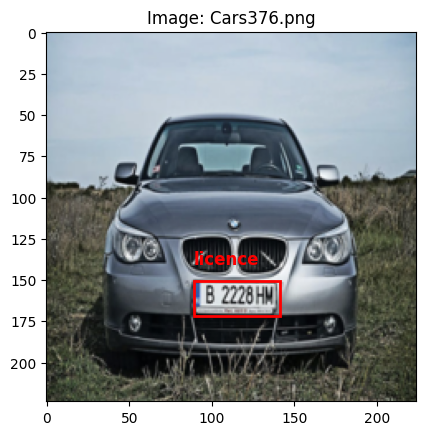

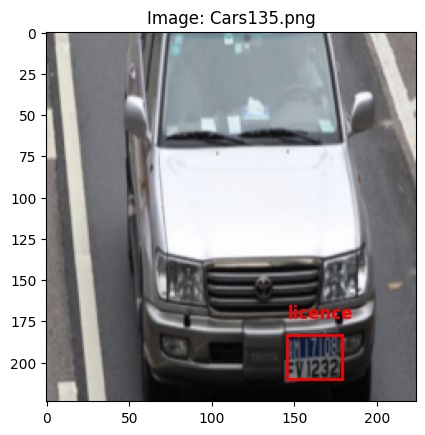

Batch 40
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 28.0949,  84.4800, 100.2305, 110.7200]]), tensor([[109.2000, 159.6938, 153.4400, 224.0000]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars273.png', 'Cars314.png']


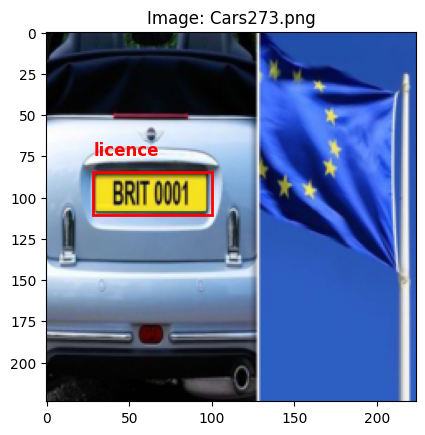

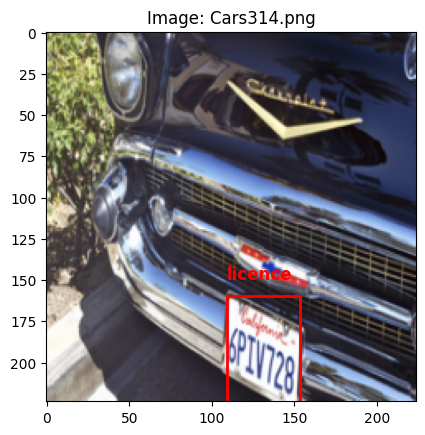

Batch 41
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 98.0757, 116.4800, 142.2703, 136.6400]]), tensor([[ 24.6400, 105.2800,  59.9200, 119.8400],
        [165.7600, 136.6400, 200.4800, 151.2000]])]
Labels: [['licence'], ['licence', 'licence']]
Filenames: ['Cars404.png', 'Cars358.png']


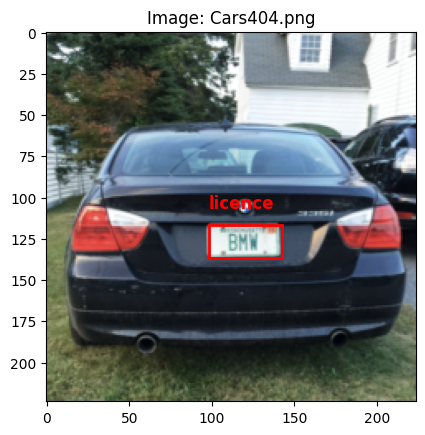

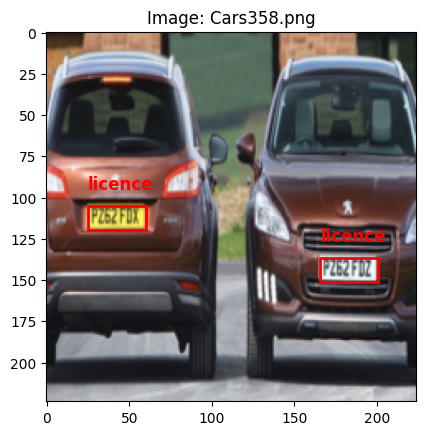

Batch 42
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[156.0945, 100.8855, 194.4567, 121.4046]]), tensor([[128.2400,  98.5600, 151.2000, 108.0800]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars374.png', 'Cars2.png']


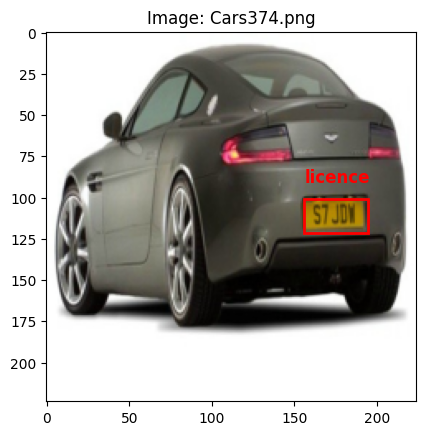

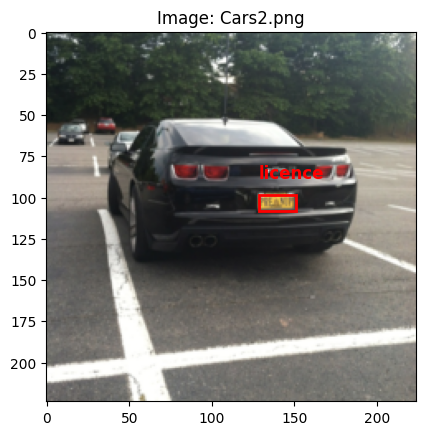

Batch 43
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 30.9867, 152.8178,  82.5067, 183.1822]]), tensor([[ 86.2189, 119.8794, 119.1849, 150.2713]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars386.png', 'Cars129.png']


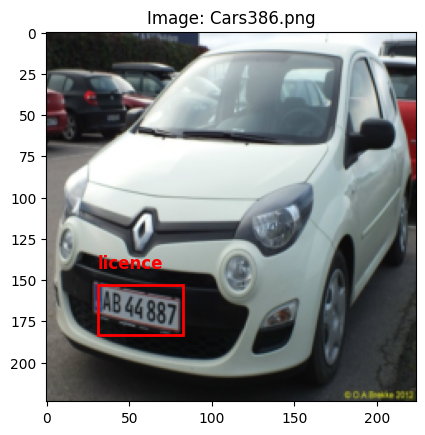

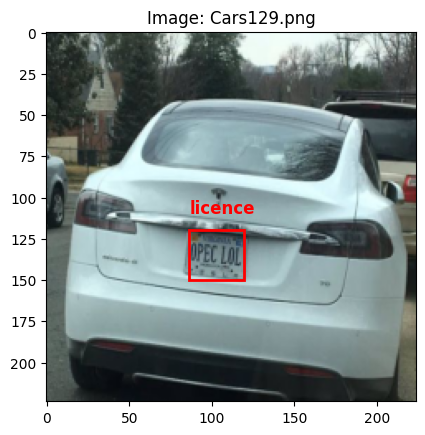

Batch 44
Images shape: torch.Size([2, 3, 224, 224])
Bounding boxes: [tensor([[ 92.9600, 113.2043, 115.3600, 123.6416]]), tensor([[ 66.6400,  21.9022, 158.4800,  68.6933]])]
Labels: [['licence'], ['licence']]
Filenames: ['Cars7.png', 'Cars73.png']


KeyboardInterrupt: 

In [ ]:
import torch
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
import matplotlib.patches as patches

def collate_fn(batch):
    """
    Custom collate function for handling variable-length bounding boxes and labels.

    Args:
        batch: A list of tuples (image, bboxes, labels, filename) where:
            - image: Tensor of shape (C, H, W)
            - bboxes: Tensor of shape (num_boxes, 4)
            - labels: List of labels corresponding to each bounding box
            - filename: String representing the image file name

    Returns:
        Tuple containing:
        - images: Tensor of shape (batch_size, C, H, W)
        - bboxes: List of bounding box tensors, where each element is a tensor of shape (num_boxes, 4)
        - labels: List of labels, where each element is a list of strings
        - filenames: List of filenames
    """
    images = []
    bboxes = []
    labels = []
    filenames = []

    # Unpack each item in the batch and append it to the respective list
    for item in batch:
        images.append(item[0])       # Image tensor
        bboxes.append(item[1])       # Bounding boxes tensor
        labels.append(item[2])       # Labels list
        filenames.append(item[3])    # Filename string

    # Stack the images into a single tensor (batch_size, C, H, W)
    images = torch.stack(images, dim=0)

    return images, bboxes, labels, filenames

# Directories for XML annotations and images
annotations_dir = '/content/'
img_dir = '/content/'

# Define transformations
transform = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize images to 224x224
    transforms.ToTensor()  # Convert images to tensors
])

# Dataset
car_dataset = CarLicensePlateDataset(annotations_dir='/content/', img_dir='/content/', transform=transform)

# Dataloader
data_loader = DataLoader(dataset=car_dataset, batch_size=2, shuffle=True, num_workers=2, collate_fn=collate_fn)

# Test the DataLoader with multiple bounding boxes
for batch_idx, (images, bboxes, labels, filenames) in enumerate(data_loader):
    print(f"Batch {batch_idx + 1}")
    print("Images shape:", images.shape)
    print("Bounding boxes:", bboxes)
    print("Labels:", labels)
    print("Filenames:", filenames)

    # Loop through the entire batch and plot each image with its bounding boxes
    for i in range(len(images)):
        # Prepare the image and bounding boxes
        sample_image = images[i].permute(1, 2, 0).numpy()  # Convert from C x H x W to H x W x C
        sample_bboxes = bboxes[i]
        sample_labels = labels[i]
        sample_filename = filenames[i]

        # Plot the image and its bounding boxes
        fig, ax = plt.subplots()
        ax.imshow(sample_image)

        # Loop through the bounding boxes and draw each one
        for bbox, label in zip(sample_bboxes, sample_labels):
            xmin, ymin, xmax, ymax = bbox

            # Calculate width and height of the bounding box
            width = xmax - xmin
            height = ymax - ymin

            # Create a rectangle patch and add it to the axis
            rect = patches.Rectangle((xmin, ymin), width, height, linewidth=2, edgecolor='r', facecolor='none')
            ax.add_patch(rect)

            # Optionally: Add the label text near the bounding box
            ax.text(xmin, ymin - 10, label, color='red', fontsize=12, weight='bold')

        plt.title(f"Image: {sample_filename}")
        plt.show()

    break  # Only show the first batch for testing
